In [ ]:
!pip install tflite-support-nightly

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 60.8/60.8 MB 11.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 162.1/162.1 kB 9.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 243.3/243.3 kB 15.5 MB/s eta 0:00:00
  Attempting uninstall: protobuf
    Found existing installation: protobuf 5.29.4
    Uninstalling protobuf-5.29.4:
      Successfully uninstalled protobuf-5.29.4
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
grpcio-status 1.71.0 requires protobuf<6.0dev,>=5.26.1, but you have protobuf 3.20.3 which is incompatible.
tensorflow-metadata 1.17.1 requires protobuf<6.0.0,>=4.25.2; python_version >= "3.11", but you have protobuf 3.20.3 which is incompatible.
ydf 0.11.0 requires protobuf<6.0.0,>=5.29.1, but you have protobuf 3.20.3 which is incompatible.


In [ ]:
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="XRR8Gd9Xad0UeqknLd7A")
project = rf.workspace("tutututu").project("nail_segmentation-jc9vy")
version = project.version(4)
dataset = version.download("coco-segmentation")


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 85.3/85.3 kB 8.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.8/66.8 kB 5.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.9/49.9 MB 48.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 119.8 MB/s eta 0:00:00
  Attempting uninstall: opencv-python-headless
    Found existing installation: opencv-python-headless 4.11.0.86
    Uninstalling opencv-python-headless-4.11.0.86:
      Successfully uninstalled opencv-python-headless-4.11.0.86
  Attempting uninstall: idna
    Found existing installation: idna 3.10
    Uninstalling idna-3.10:
      Successfully uninstalled idna-3.10
loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to Nail_Segmentation-4 in coco-segmentation:: 100%|██████████| 38145/38145 [00:05<00:00, 6600.75it/s]


In [ ]:
import os
import json
import numpy as np
import tensorflow as tf
from pycocotools.coco import COCO
from tensorflow import keras
from tensorflow.keras import layers
import cv2
import matplotlib.pyplot as plt


In [ ]:
class VisualizationCallback(keras.callbacks.Callback):
    def __init__(self, valid_dataset, img_size=(256, 256), num_images=3):
        self.valid_dataset = valid_dataset
        self.img_size = img_size
        self.num_images = num_images

    def on_epoch_end(self, epoch, logs=None):
        fig, axes = plt.subplots(self.num_images, 3, figsize=(12, 4 * self.num_images))

        for i in range(self.num_images):
            idx = np.random.randint(len(self.valid_dataset))
            img, true_mask = self.valid_dataset.load_image_and_mask(idx)

            # Predict mask using the trained model
            pred_mask = self.model.predict(np.expand_dims(img, axis=0), verbose=0)
            pred_mask = (pred_mask > 0.5).astype(np.float32)  # Apply thresholding for binary mask

            if self.num_images == 1:
                ax = axes
            else:
                ax = axes[i]

            # Original Image
            ax[0].imshow(img)
            ax[0].set_title('Original Image')
            ax[0].axis('off')

            # Ground Truth Mask
            ax[1].imshow(true_mask.squeeze(), cmap='gray')
            ax[1].set_title('Ground Truth Mask')
            ax[1].axis('off')

            # Predicted Mask
            ax[2].imshow(pred_mask.squeeze(), cmap='gray')
            ax[2].set_title('Predicted Mask')
            ax[2].axis('off')

        plt.tight_layout()
        plt.show()


In [ ]:
from tensorflow.keras import layers, models
import tensorflow as tf
from tensorflow.keras.applications import EfficientNetB7

def create_deeplabv3plus_model(input_shape=(256, 256, 3), num_classes=1, feature_channels=256):
    """
    Membuat model segmentasi gaya DeepLab/FPN dengan EfficientNet sebagai backbone.
    Fokus pada penggabungan fitur top-down dan refinement head.
    """
    base_model = EfficientNetB7(input_shape=input_shape, include_top=False, weights='imagenet')

    try:
        f3 = base_model.get_layer("block3a_expand_activation").output  # Stride 4 (64x64)
        f4 = base_model.get_layer("block4a_expand_activation").output  # Stride 8 (32x32)
        f8 = base_model.get_layer("block6a_expand_activation").output  # Stride 16 (16x16)
        f16 = base_model.output  # Output akhir
        print("Berhasil mendapatkan layer fitur EfficientNetB0.")
    except ValueError as e:
        print(f"Error mendapatkan layer: {e}. Periksa nama layer di base_model.summary().")
        return None

    # --- Top-Down Pathway ---
    p16 = layers.Conv2D(feature_channels, (1, 1), padding="same", use_bias=False)(f16)
    p16 = layers.BatchNormalization()(p16)
    p16 = layers.Activation("relu")(p16)
    p16_upsampled = layers.UpSampling2D(size=(2, 2), interpolation="bilinear")(p16)

    p8 = layers.Conv2D(feature_channels, (1, 1), padding="same", use_bias=False)(f8)
    p8 = layers.BatchNormalization()(p8)
    p8 = layers.Activation("relu")(p8)
    p8 = layers.Add()([p16_upsampled, p8])
    p8 = layers.SeparableConv2D(feature_channels, (3, 3), padding="same", use_bias=False)(p8)
    p8 = layers.BatchNormalization()(p8)
    p8 = layers.Activation("relu")(p8)
    p8_upsampled = layers.UpSampling2D(size=(2, 2), interpolation="bilinear")(p8)

    p4 = layers.Conv2D(feature_channels, (1, 1), padding="same", use_bias=False)(f4)
    p4 = layers.BatchNormalization()(p4)
    p4 = layers.Activation("relu")(p4)
    p4 = layers.Add()([p8_upsampled, p4])
    p4 = layers.SeparableConv2D(feature_channels, (3, 3), padding="same", use_bias=False)(p4)
    p4 = layers.BatchNormalization()(p4)
    p4 = layers.Activation("relu")(p4)

    p4_upsampled = layers.UpSampling2D(size=(2, 2), interpolation="bilinear")(p4)
    p3 = layers.Conv2D(feature_channels, (1, 1), padding="same", use_bias=False)(f3)
    p3 = layers.BatchNormalization()(p3)
    p3 = layers.Activation("relu")(p3)
    p3 = layers.Add()([p4_upsampled, p3])
    p3 = layers.SeparableConv2D(feature_channels, (3, 3), padding="same", use_bias=False)(p3)
    p3 = layers.BatchNormalization()(p3)
    p3 = layers.Activation("relu")(p3)
    decoder_output = p3

    head = layers.SeparableConv2D(feature_channels, (3, 3), padding='same', use_bias=False)(decoder_output)
    head = layers.BatchNormalization()(head)
    head = layers.Activation('relu')(head)

    head = layers.SeparableConv2D(feature_channels, (3, 3), padding='same', use_bias=False)(head)
    head = layers.BatchNormalization()(head)
    head = layers.Activation('relu')(head)

    head = layers.Dropout(0.3)(head)

    final_upsample_factor = 4
    head = layers.UpSampling2D(size=(final_upsample_factor, final_upsample_factor), interpolation='bilinear')(head)

    outputs = layers.Conv2D(num_classes, (1, 1), activation='sigmoid', name='output_mask')(head)

    model = models.Model(inputs=base_model.input, outputs=outputs, name="FPN_Like_DeepLab_EfficientNetB0")
    return model


In [ ]:
import os
import cv2
import numpy as np
from pycocotools.coco import COCO

class COCOSegmentationDataset:
    def __init__(self, img_dir, annotation_path, img_size=(256, 256), max_samples=50000):
        self.img_dir = img_dir
        self.coco = COCO(annotation_path)
        self.img_size = img_size
        self.max_samples = max_samples
        self.index = 0  # Tambahkan indeks untuk iterasi berurutan

        # Get all image IDs
        self.img_ids = self.coco.getImgIds()

        # Filter out invalid images
        self.valid_img_ids = self._filter_invalid_images()

        # Limit dataset to max_samples
        if len(self.valid_img_ids) > self.max_samples:
            self.valid_img_ids = self.valid_img_ids[:self.max_samples]

    def __len__(self):
        return len(self.valid_img_ids)

    def _filter_invalid_images(self):
        valid_img_ids = []
        for img_id in self.img_ids:
            img_info = self.coco.loadImgs(img_id)[0]
            img_path = os.path.join(self.img_dir, img_info['file_name'])

            if not os.path.exists(img_path):
                print(f"Warning: Image file not found: {img_path}")
                continue

            img = cv2.imread(img_path)
            if img is None:
                print(f"Warning: Could not read image at path: {img_path}")
                continue

            valid_img_ids.append(img_id)

        return valid_img_ids

    def load_image_and_mask(self, index):
        img_info = self.coco.loadImgs(self.valid_img_ids[index])[0]
        img_path = os.path.join(self.img_dir, img_info['file_name'])

        img = cv2.imread(img_path)
        if img is None:
            print(f"Error: Could not read image at path: {img_path}")
            return None, None

        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        img = cv2.resize(img, self.img_size)

        mask = np.zeros(self.img_size + (1,), dtype=np.float32)
        ann_ids = self.coco.getAnnIds(imgIds=img_info['id'])
        anns = self.coco.loadAnns(ann_ids)

        for ann in anns:
            seg = self.coco.annToMask(ann)
            seg = cv2.resize(seg, self.img_size)
            mask[seg > 0] = 1.0

        return img / 255.0, mask

    def generate_dataset(self, batch_size=32):
        while True:
            batch_images = []
            batch_masks = []

            for _ in range(batch_size):
                # Ambil data berdasarkan urutan indeks, lalu maju ke data berikutnya
                img, mask = self.load_image_and_mask(self.index)
                self.index += 1

                # Reset indeks jika mencapai akhir dataset
                if self.index >= len(self.valid_img_ids):
                    self.index = 0

                if img is None or mask is None:
                    continue

                batch_images.append(img)
                batch_masks.append(mask)

            if batch_images and batch_masks:
                yield (np.array(batch_images), np.array(batch_masks))


In [ ]:
TRAIN_IMG_DIR = '/content/Nail_Segmentation-4/train/'
TRAIN_ANN_PATH = '/content/Nail_Segmentation-4/train/_annotations.coco.json'
VALID_IMG_DIR = '/content/Nail_Segmentation-4/valid/'
VALID_ANN_PATH = '/content/Nail_Segmentation-4/valid/_annotations.coco.json'
train_dataset = COCOSegmentationDataset(TRAIN_IMG_DIR, TRAIN_ANN_PATH)
valid_dataset = COCOSegmentationDataset(VALID_IMG_DIR, VALID_ANN_PATH)

loading annotations into memory...
Done (t=3.15s)
creating index...
index created!
loading annotations into memory...
Done (t=0.03s)
creating index...
index created!


In [ ]:
import matplotlib.pyplot as plt
import numpy as np
from tensorflow.keras.callbacks import Callback
class PlotHistoryCallback(Callback):
    def __init__(self, validation_data, save_path="training_progress.png"):
        super().__init__()
        self.validation_data = validation_data
        self.history = {"accuracy": [], "val_accuracy": [], "loss": [], "val_loss": []}
        self.save_path = save_path

    def on_epoch_end(self, epoch, logs=None):
        # Simpan data history
        self.history["accuracy"].append(logs["accuracy"])
        self.history["val_accuracy"].append(logs["val_accuracy"])
        self.history["loss"].append(logs["loss"])
        self.history["val_loss"].append(logs["val_loss"])

        # Buat plot
        fig, ax = plt.subplots(1, 2, figsize=(10, 4))

        # Accuracy plot
        ax[0].plot(self.history["accuracy"], label="Train Accuracy")
        ax[0].plot(self.history["val_accuracy"], label="Val Accuracy")
        ax[0].set_title("Model Accuracy")
        ax[0].legend()

        # Loss plot
        ax[1].plot(self.history["loss"], label="Train Loss")
        ax[1].plot(self.history["val_loss"], label="Val Loss")
        ax[1].set_title("Model Loss")
        ax[1].legend()

        plt.tight_layout()
        plt.show()

plot_callback = PlotHistoryCallback(valid_dataset, save_path="training_progress.png")

In [ ]:
def dice_loss(y_true, y_pred, smooth=1e-6):
    y_true_f = tf.reshape(y_true, [-1])
    y_pred_f = tf.reshape(y_pred, [-1])
    intersection = tf.reduce_sum(y_true_f * y_pred_f)
    return 1 - (2. * intersection + smooth) / (tf.reduce_sum(y_true_f) + tf.reduce_sum(y_pred_f) + smooth)

def combined_loss(y_true, y_pred):
    bce = tf.keras.losses.binary_crossentropy(y_true, y_pred)
    d_loss = dice_loss(y_true, y_pred)
    return bce + d_loss


In [ ]:
model = create_deeplabv3plus_model()
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=1e-3),
    loss=combined_loss,
    metrics=[
        'accuracy',
        tf.keras.metrics.Precision(),
        tf.keras.metrics.Recall()
    ]
)

model.summary()


258076736/258076736 ━━━━━━━━━━━━━━━━━━━━ 12s 0us/step
Berhasil mendapatkan layer fitur EfficientNetB0.


Model: "FPN_Like_DeepLab_EfficientNetB0"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_1       │ (None, 256, 256,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ rescaling           │ (None, 256, 256,  │          0 │ input_layer_1[0]… │
│ (Rescaling)         │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ normalization       │ (None, 256, 256,  │          7 │ rescaling[0][0]   │
│ (Normalization)     │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ rescaling_1         │ (None, 256, 256,  │          0 │ normalization[0]… │
│ (Rescaling)         │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ stem_conv_pad       │ (None, 257, 257,  │          0 │ rescaling_1[0][0] │
│ (ZeroPadding2D)     │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ stem_conv (Conv2D)  │ (None, 128, 128,  │      1,728 │ stem_conv_pad[0]… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ stem_bn             │ (None, 128, 128,  │        256 │ stem_conv[0][0]   │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ stem_activation     │ (None, 128, 128,  │          0 │ stem_bn[0][0]     │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1a_dwconv      │ (None, 128, 128,  │        576 │ stem_activation[… │
│ (DepthwiseConv2D)   │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1a_bn          │ (None, 128, 128,  │        256 │ block1a_dwconv[0… │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1a_activation  │ (None, 128, 128,  │          0 │ block1a_bn[0][0]  │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1a_se_squeeze  │ (None, 64)        │          0 │ block1a_activati… │
│ (GlobalAveragePool… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1a_se_reshape  │ (None, 1, 1, 64)  │          0 │ block1a_se_squee… │
│ (Reshape)           │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1a_se_reduce   │ (None, 1, 1, 16)  │      1,040 │ block1a_se_resha… │
│ (Conv2D)            │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1a_se_expand   │ (None, 1, 1, 64)  │      1,088 │ block1a_se_reduc… │
│ (Conv2D)            │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1a_se_excite   │ (None, 128, 128,  │          0 │ block1a_activati… │
│ (Multiply)          │ 64)               │            │ block1a_se_expan… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1a_project_co… │ (None, 128, 128,  │      2,048 │ block1a_se_excit

 Total params: 65,642,392 (250.41 MB)

 Trainable params: 65,327,057 (249.20 MB)

 Non-trainable params: 315,335 (1.20 MB)

In [ ]:
train_generator = train_dataset.generate_dataset(batch_size=32)
valid_generator = valid_dataset.generate_dataset(batch_size=32)

In [ ]:
from tensorflow.keras.callbacks import EarlyStopping

early_stopping = EarlyStopping(
    monitor="val_loss",
    patience=5,
    restore_best_weights=True,
    verbose=1
)

In [ ]:
from tensorflow.keras.callbacks import ReduceLROnPlateau

reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=3, min_lr=1e-6)

In [ ]:
from tensorflow.keras.callbacks import ModelCheckpoint

checkpoint_path = "check.keras"

# if os.path.exists(checkpoint_path):
#     print("Loading weights from checkpoint...")
#     model.load_weights(checkpoint_path)

checkpoint_callback = ModelCheckpoint(
    filepath=checkpoint_path,
    monitor='val_loss',
    save_best_only=True,
    mode='min',  # karena kita memonitor loss (minimum lebih baik)
    save_freq='epoch',  # simpan setiap epoch
    verbose=1
)

history = model.fit(
    train_generator,
    steps_per_epoch=len(train_dataset) // 32,
    epochs=20,
    validation_data=valid_generator,
    validation_steps=len(valid_dataset) // 32,
    callbacks=[
        # VisualizationCallback(valid_dataset),
        # early_stopping,
        reduce_lr,
        # plot_callback
    ]
)


Epoch 1/20
1151/1151 ━━━━━━━━━━━━━━━━━━━━ 753s 352ms/step - accuracy: 0.9649 - loss: 0.2927 - precision_1: 0.7890 - recall_1: 0.8651 - val_accuracy: 0.9058 - val_loss: 1.2196 - val_precision_1: 0.0601 - val_recall_1: 0.0544 - learning_rate: 0.0010
Epoch 2/20
1151/1151 ━━━━━━━━━━━━━━━━━━━━ 381s 331ms/step - accuracy: 0.9875 - loss: 0.1340 - precision_1: 0.9198 - recall_1: 0.9242 - val_accuracy: 0.9453 - val_loss: 1.2319 - val_precision_1: 0.4562 - val_recall_1: 0.1663 - learning_rate: 0.0010
Epoch 3/20
1151/1151 ━━━━━━━━━━━━━━━━━━━━ 380s 331ms/step - accuracy: 0.9905 - loss: 0.1005 - precision_1: 0.9403 - recall_1: 0.9418 - val_accuracy: 0.5968 - val_loss: 2.8066 - val_precision_1: 0.0847 - val_recall_1: 0.6887 - learning_rate: 0.0010
Epoch 4/20
1151/1151 ━━━━━━━━━━━━━━━━━━━━ 379s 330ms/step - accuracy: 0.9911 - loss: 0.0937 - precision_1: 0.9445 - recall_1: 0.9454 - val_accuracy: 0.9487 - val_loss: 1.3969 - val_precision_1: 0.7930 - val_recall_1: 0.0392 - learning_rate: 0.0010
Epoch 5/

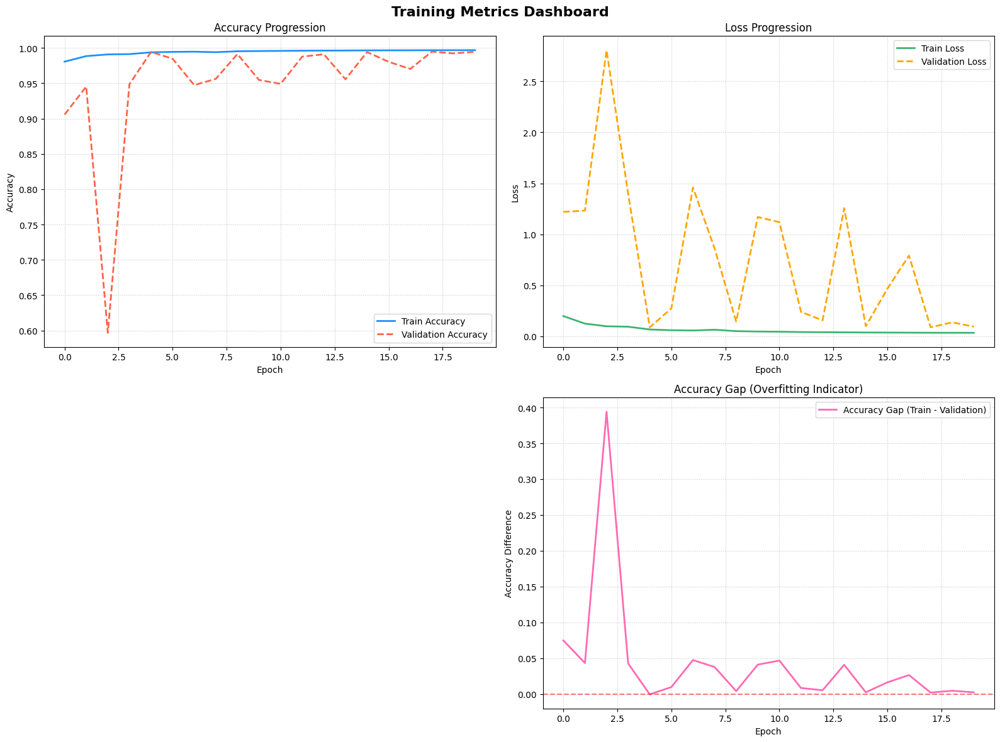

Training Insights:
Best Training Accuracy: 0.9969
Best Validation Accuracy: 0.9948
Lowest Training Loss: 0.0327
Lowest Validation Loss: 0.0862

Overfitting Indicators:
Maximum Accuracy Gap: 0.3941
Maximum Loss Gap: 2.7099



In [ ]:
import matplotlib.pyplot as plt
import numpy as np

def plot_training_metrics(history, save_path=None):
    """
    Create a comprehensive visualization of training metrics using pure Matplotlib

    Parameters:
    -----------
    history : keras.callbacks.History
        Training history object from model.fit()
    save_path : str, optional
        Path to save the figure if desired
    """
    # Color palette
    colors = {
        'train_accuracy': '#1E90FF',  # Dodger Blue
        'val_accuracy': '#FF6347',    # Tomato Red
        'train_loss': '#3CB371',      # Medium Sea Green
        'val_loss': '#FFA500',        # Orange
        'lr': '#9370DB',              # Medium Purple
        'gap': '#FF69B4'              # Hot Pink
    }

    # Create a figure with multiple subplots
    fig, axs = plt.subplots(2, 2, figsize=(16, 12))
    fig.suptitle('Training Metrics Dashboard', fontsize=16, fontweight='bold')

    # 1. Accuracy Plot
    axs[0, 0].plot(
        history.history['accuracy'],
        label='Train Accuracy',
        color=colors['train_accuracy'],
        linewidth=2
    )
    axs[0, 0].plot(
        history.history['val_accuracy'],
        label='Validation Accuracy',
        color=colors['val_accuracy'],
        linestyle='--',
        linewidth=2
    )
    axs[0, 0].set_title('Accuracy Progression', fontsize=12)
    axs[0, 0].set_xlabel('Epoch', fontsize=10)
    axs[0, 0].set_ylabel('Accuracy', fontsize=10)
    axs[0, 0].legend()
    axs[0, 0].grid(True, linestyle=':', alpha=0.7)

    # 2. Loss Plot
    axs[0, 1].plot(
        history.history['loss'],
        label='Train Loss',
        color=colors['train_loss'],
        linewidth=2
    )
    axs[0, 1].plot(
        history.history['val_loss'],
        label='Validation Loss',
        color=colors['val_loss'],
        linestyle='--',
        linewidth=2
    )
    axs[0, 1].set_title('Loss Progression', fontsize=12)
    axs[0, 1].set_xlabel('Epoch', fontsize=10)
    axs[0, 1].set_ylabel('Loss', fontsize=10)
    axs[0, 1].legend()
    axs[0, 1].grid(True, linestyle=':', alpha=0.7)

    # 3. Additional Metrics Plot (Precision/Recall if available)
    additional_metrics = [
        'precision', 'val_precision',
        'recall', 'val_recall'
    ]

    # Check if additional metrics exist
    plot_additional_metrics = all(metric in history.history for metric in additional_metrics)

    if plot_additional_metrics:
        axs[1, 0].plot(
            history.history['precision'],
            label='Train Precision',
            color='#4682B4',
            linewidth=2
        )
        axs[1, 0].plot(
            history.history['val_precision'],
            label='Val Precision',
            color='#DC143C',
            linestyle='--',
            linewidth=2
        )
        axs[1, 0].plot(
            history.history['recall'],
            label='Train Recall',
            color='#2E8B57',
            linewidth=2
        )
        axs[1, 0].plot(
            history.history['val_recall'],
            label='Val Recall',
            color='#FF4500',
            linestyle='--',
            linewidth=2
        )
        axs[1, 0].set_title('Precision and Recall', fontsize=12)
        axs[1, 0].set_xlabel('Epoch', fontsize=10)
        axs[1, 0].set_ylabel('Score', fontsize=10)
        axs[1, 0].legend()
        axs[1, 0].grid(True, linestyle=':', alpha=0.7)

    # 4. Performance Gap Visualization
    train_accuracy = history.history['accuracy']
    val_accuracy = history.history['val_accuracy']

    performance_gap = np.array(train_accuracy) - np.array(val_accuracy)
    axs[1, 1].plot(
        performance_gap,
        label='Accuracy Gap (Train - Validation)',
        color=colors['gap'],
        linewidth=2
    )
    axs[1, 1].axhline(y=0, color='r', linestyle='--', alpha=0.5)
    axs[1, 1].set_title('Accuracy Gap (Overfitting Indicator)', fontsize=12)
    axs[1, 1].set_xlabel('Epoch', fontsize=10)
    axs[1, 1].set_ylabel('Accuracy Difference', fontsize=10)
    axs[1, 1].legend()
    axs[1, 1].grid(True, linestyle=':', alpha=0.7)

    # If additional metrics are not available, hide the third subplot
    if not plot_additional_metrics:
        fig.delaxes(axs[1, 0])

    # Adjust layout and display
    plt.tight_layout()

    # Save figure if path is provided
    if save_path:
        plt.savefig(save_path, dpi=300, bbox_inches='tight')

    plt.show()

# Example usage:
plot_training_metrics(history, save_path='training_metrics.png')

def additional_training_insights(history):
    """
    Provide additional insights into the training process

    Parameters:
    -----------
    history : keras.callbacks.History
        Training history object from model.fit()
    """
    # Compute key statistics
    best_train_accuracy = max(history.history['accuracy'])
    best_val_accuracy = max(history.history['val_accuracy'])

    lowest_train_loss = min(history.history['loss'])
    lowest_val_loss = min(history.history['val_loss'])

    # Overfitting detection
    accuracy_gap = np.array(history.history['accuracy']) - np.array(history.history['val_accuracy'])
    loss_gap = np.array(history.history['loss']) - np.array(history.history['val_loss'])

    # Print insights
    print("Training Insights:")
    print(f"Best Training Accuracy: {best_train_accuracy:.4f}")
    print(f"Best Validation Accuracy: {best_val_accuracy:.4f}")
    print(f"Lowest Training Loss: {lowest_train_loss:.4f}")
    print(f"Lowest Validation Loss: {lowest_val_loss:.4f}")

    # Overfitting indicators
    max_accuracy_gap = np.max(np.abs(accuracy_gap))
    max_loss_gap = np.max(np.abs(loss_gap))

    print("\nOverfitting Indicators:")
    print(f"Maximum Accuracy Gap: {max_accuracy_gap:.4f}")
    print(f"Maximum Loss Gap: {max_loss_gap:.4f}")

    if max_accuracy_gap > 0.1 or max_loss_gap > 0.5:
        print("\nWarning: Potential Overfitting Detected!")
    else:
        print("\nModel Training Looks Stable")

# Example usage:
additional_training_insights(history)

In [ ]:
# Baca COCO annotations
import json

annotation_file = "/content/Nail_Segmentation-4/train/_annotations.coco.json"  # Sesuaikan path

with open(annotation_file, "r") as f:
    data = json.load(f)

categories = data["categories"]
labels = [cat["name"] for cat in categories]

# Tulis labels.txt
with open("labels.txt", "w") as f:
    for label in labels:
        f.write(label + "\n")

print("Berhasil buat labels.txt:", labels)


Berhasil buat labels.txt: ['nails', 'nail']


In [ ]:
converter = tf.lite.TFLiteConverter.from_keras_model(model)
converter.optimizations = [tf.lite.Optimize.DEFAULT]
tflite_model = converter.convert()

# Save TFLite Model
with open('/content/nailsegmentation_deeplabv3.tflite', 'wb') as f:
    f.write(tflite_model)


Saved artifact at '/tmp/tmphy6sayj0'. The following endpoints are available:

* Endpoint 'serve'
  args_0 (POSITIONAL_ONLY): TensorSpec(shape=(None, 256, 256, 3), dtype=tf.float32, name='keras_tensor_190')
Output Type:
  TensorSpec(shape=(None, 256, 256, 1), dtype=tf.float32, name=None)
Captures:
  136410050859024: TensorSpec(shape=(1, 1, 1, 3), dtype=tf.float32, name=None)
  136410050859984: TensorSpec(shape=(1, 1, 1, 3), dtype=tf.float32, name=None)
  136410063171856: TensorSpec(shape=(), dtype=tf.resource, name=None)
  136410063172240: TensorSpec(shape=(), dtype=tf.resource, name=None)
  136410063173200: TensorSpec(shape=(), dtype=tf.resource, name=None)
  136410063172432: TensorSpec(shape=(), dtype=tf.resource, name=None)
  136410063169360: TensorSpec(shape=(), dtype=tf.resource, name=None)
  136410063174160: TensorSpec(shape=(), dtype=tf.resource, name=None)
  136410063173776: TensorSpec(shape=(), dtype=tf.resource, name=None)
  136410063175312: TensorSpec(shape=(), dtype=tf.resou

In [ ]:
model.save("check.keras")

In [ ]:
!pip uninstall tflite-support tensorflow-lite-support -y

In [ ]:
!pip install tflite-support-nightly --upgrade

In [ ]:
from tflite_support.metadata_writers import image_segmenter
from tflite_support.metadata_writers import writer_utils

In [ ]:
ImageSegmenterWriter = image_segmenter.MetadataWriter
_MODEL_PATH = "/content/nailsegmentation_deeplabv3.tflite"
# Task Library expects label files that are in the same format as the one below.
_LABEL_FILE = "labels.txt"
_SAVE_TO_PATH = "/content/final_nail_with_metadata.tflite"
# Normalization parameters are required when reprocessing the image. It is
# optional if the image pixel values are in the range of [0, 255] and the input
# tensor is quantized to uint8. See the introduction for normalization and
# quantization parameters below for more details.
# https://www.tensorflow.org/lite/models/convert/metadata#normalization_and_quantization_parameters)
_INPUT_NORM_MEAN = 127.5
_INPUT_NORM_STD = 127.5

# Create the metadata writer.
writer = ImageSegmenterWriter.create_for_inference(
    writer_utils.load_file(_MODEL_PATH), [_INPUT_NORM_MEAN], [_INPUT_NORM_STD],
    [_LABEL_FILE])

# Verify the metadata generated by metadata writer.
print(writer.get_metadata_json())

# Populate the metadata into the model.
writer_utils.save_file(writer.populate(), _SAVE_TO_PATH)

{
  "name": "ImageSegmenter",
  "description": "Semantic image segmentation predicts whether each pixel of an image is associated with a certain class.",
  "subgraph_metadata": [
    {
      "input_tensor_metadata": [
        {
          "name": "image",
          "description": "Input image to be segmented.",
          "content": {
            "content_properties_type": "ImageProperties",
            "content_properties": {
              "color_space": "RGB"
            }
          },
          "process_units": [
            {
              "options_type": "NormalizationOptions",
              "options": {
                "mean": [
                  127.5
                ],
                "std": [
                  127.5
                ]
              }
            }
          ],
          "stats": {
            "max": [
              1.0
            ],
            "min": [
              -1.0
            ]
          }
        }
      ],
      "output_tensor_metadata": [
        {
  

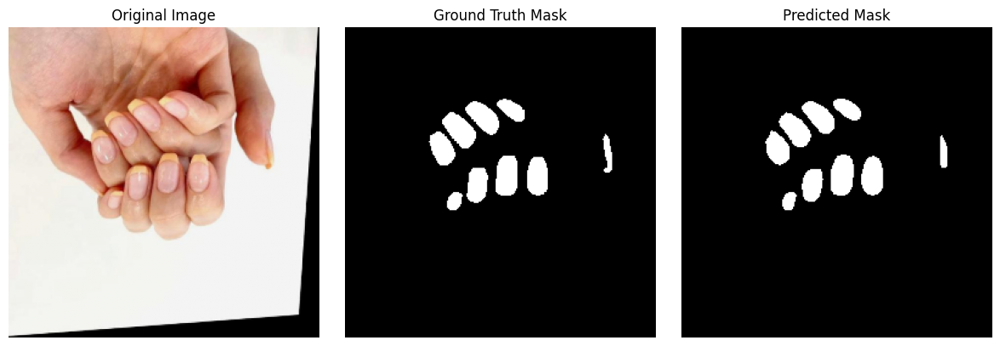

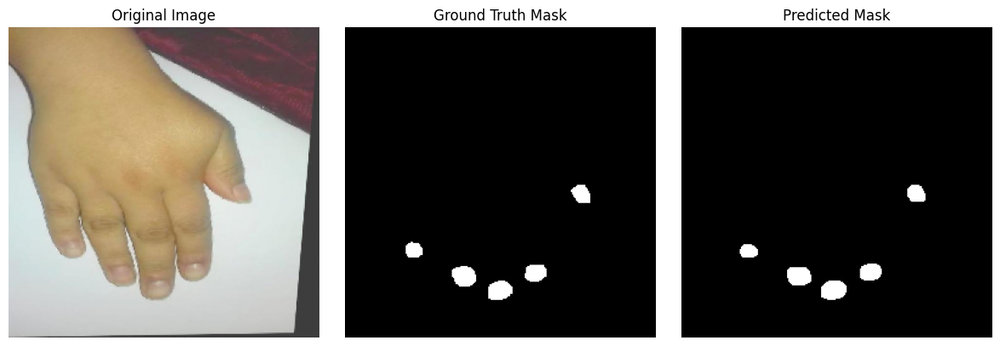

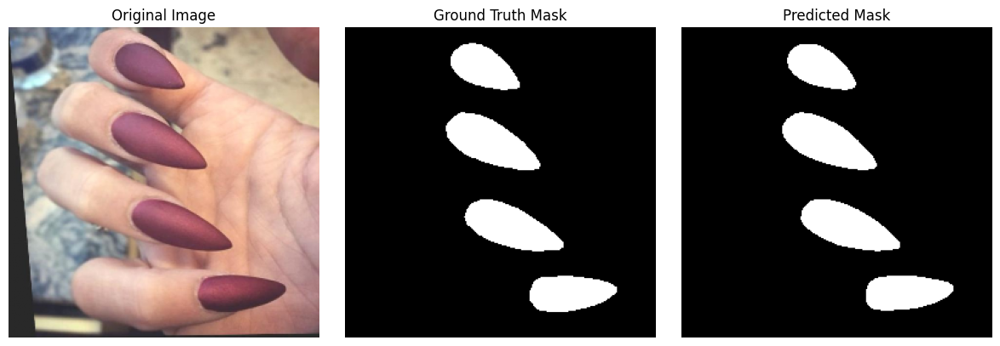

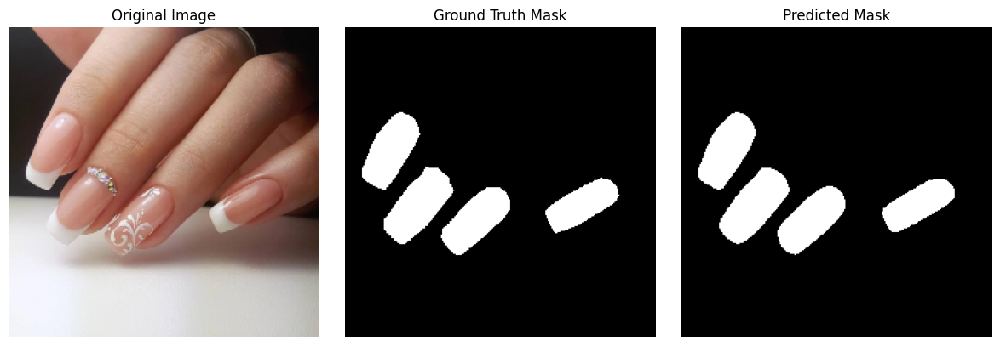

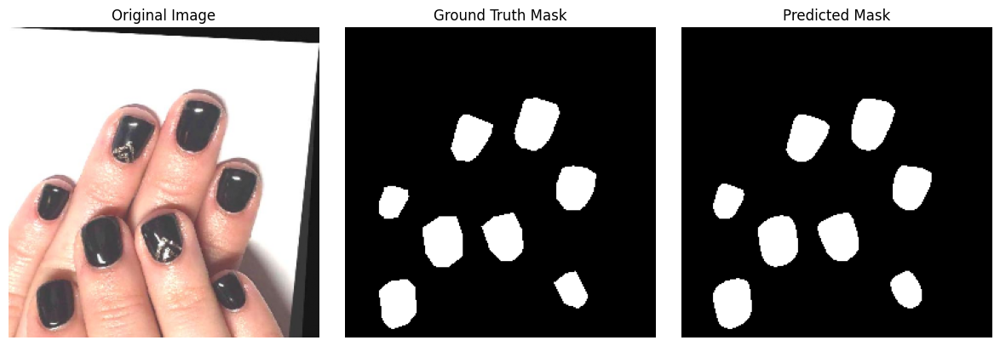

...

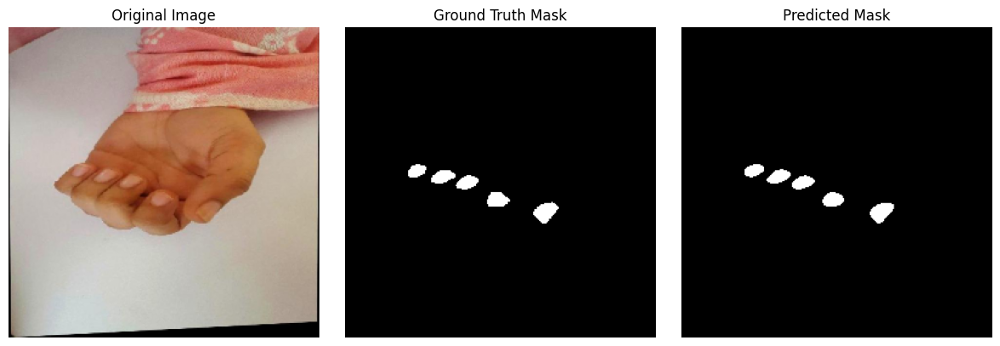

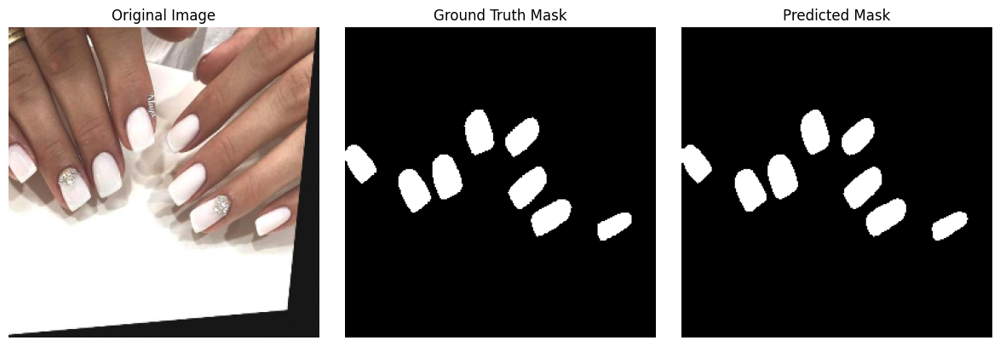

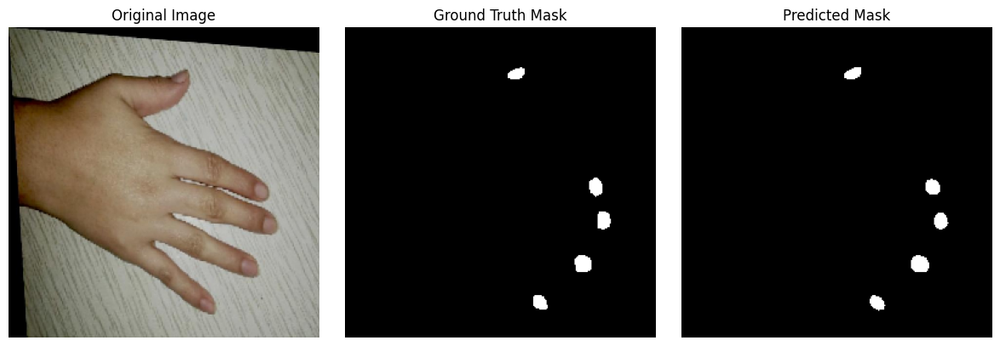

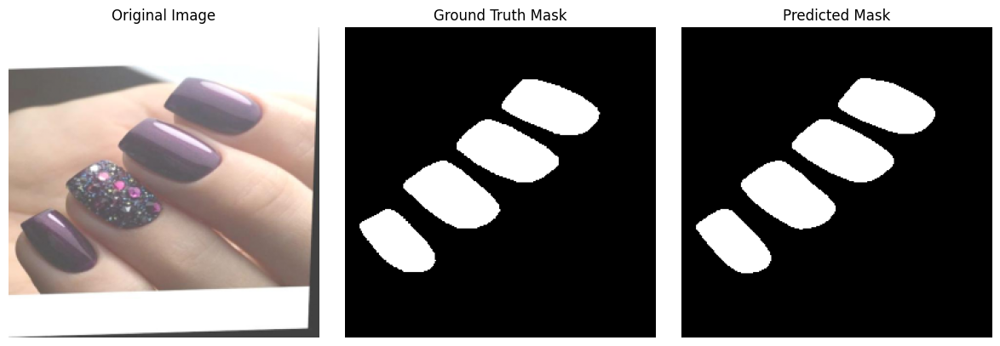

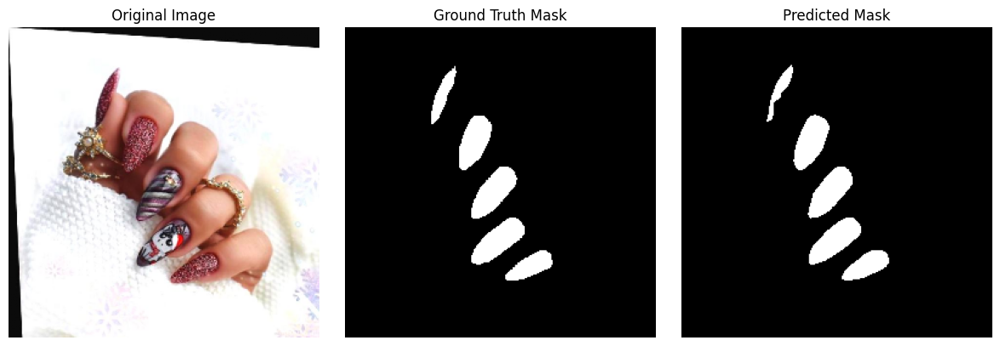

In [ ]:
# prompt: inference with the model 12 image of train dataset, and show the original, mask, and predict, dont use the existing class

import matplotlib.pyplot as plt
import numpy as np

# Assuming 'model' and 'valid_dataset' are defined from the previous code

# Select 3 images from the validation dataset
num_images = 100
for i in range(num_images):
    idx = i * 4 # Use a fixed index to get the first 12 images
    img, true_mask = train_dataset.load_image_and_mask(idx)

    # Predict mask using the trained model
    pred_mask = model.predict(np.expand_dims(img, axis=0), verbose=0)
    pred_mask = (pred_mask > 0.5).astype(np.float32)

    # Display the results
    fig, axes = plt.subplots(1, 3, figsize=(12, 4))

    axes[0].imshow(img)
    axes[0].set_title('Original Image')
    axes[0].axis('off')

    axes[1].imshow(true_mask.squeeze(), cmap='gray')
    axes[1].set_title('Ground Truth Mask')
    axes[1].axis('off')

    axes[2].imshow(pred_mask.squeeze(), cmap='gray')
    axes[2].set_title('Predicted Mask')
    axes[2].axis('off')

    plt.tight_layout()
    plt.show()


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

ValueError: mount failed